# Sensorimotor synchronization project

kcho, Friday, September 22, 2017

## Import libraries

In [1495]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from peakutils.peak import indexes
import scipy.interpolate as interpolate
from scipy.signal import butter, lfilter, freqz, find_peaks_cwt
from scipy.integrate import simps
from numpy import trapz
import peakutils
from IPython.display import Image, display


%matplotlib inline

In [1494]:
import numpy as np
from scipy.integrate import simps
from numpy import trapz


# The y values.  A numpy array is used here,
# but a python list could also be used.
y = np.array([5, 20, 4, 18, 19, 18, 7, 4])

# Compute the area using the composite trapezoidal rule.
area = trapz(y, dx=5)
print("area =", area)

# Compute the area using the composite Simpson's rule.
area = simps(y, dx=5)
print("area =", area)

area = 452.5
area = 460.0


In [1537]:
def split_df(df):
    #split the dataframe
    # difference between consecutive element
    pre_post_signal_diff = np.ediff1d(df['signal'])

    # where the difference is +1 : Signal turning on (0 --> 1)
    # 1 has been added to return the index of first 'on'
    signal_first_ones_index = np.where(pre_post_signal_diff==1)[0] + 1
    signal_first_ones_time = df.loc[signal_first_ones_index, 'time[us]'].values

    signal_last_ones_index = np.where(pre_post_signal_diff==-1)[0]
    signal_last_ones_time = df.loc[signal_last_ones_index, 'time[us]'].values

    # 300 ms
    # need to make this multiples of 360
    cut_window_div = 300000 / 360
    cut_time = signal_first_ones_index - round(cut_window_div)

    data_split = np.split(df, cut_time)[1:]
    
    return data_split

def interpolate_df(df, gap):
    f = interpolate.interp1d(df['time[us]'], df['volt(fsr)[v]'])
    y = f(np.arange(df['time[us]'].min(), df['time[us]'].max(), gap))

    f_signal = interpolate.interp1d(df['time[us]'], df['signal'], kind='nearest')
    y_signal = f_signal(np.arange(df['time[us]'].min(), df['time[us]'].max(), gap))
    
    data_reponse_interp = pd.DataFrame({'time[us]':np.arange(df['time[us]'].min(), 
                                                             df['time[us]'].max(), gap),
                                        'volt(fsr)[v]':y,
                                        'signal':y_signal})
    return data_reponse_interp
    

    
def remove_partial_peaks(df):
    cut_index_thr = np.diff(df[df['volt(fsr)[v]'] > 80].index).argmax()
    cut_index = df[df['volt(fsr)[v]'] > 80].index.values[cut_index_thr]

    # select longer part of the response
    first_df_tmp = df.ix[:cut_index]
    second_df_tmp = df.ix[cut_index:]
    get_longer_df = lambda x,y : x if len(x[x['volt(fsr)[v]']>80]) > len(y[y['volt(fsr)[v]']>80]) else y
    new = get_longer_df(first_df_tmp, second_df_tmp)
    new = new.reindex_like(df)
    new['time[us]'] = df['time[us]']
    new['signal'] = df['signal']
    new.ix[new.index[new.isnull()['volt(fsr)[v]']], 'volt(fsr)[v]'] = 0    
    
    return new

def get_peak_info(df):
    # Estimating second peak
    # Smooth data : strong smoothing
    b, a = signal.butter(4, 0.01)
    df['svolt(fsr)[v]'] = signal.filtfilt(b, a, df['volt(fsr)[v]'])

    max_response_index_from_strong_smoothing = df['svolt(fsr)[v]'].idxmax()
    second_window_index = 50
    higher_window_bound_2nd_peak = max_response_index_from_strong_smoothing + second_window_index

    # Second peak
    # Always on the right of the max_response_index_from _strong_smoothing
    second_peak_index = df['volt(fsr)[v]'].ix[max_response_index_from_strong_smoothing:higher_window_bound_2nd_peak].idxmax()
    second_peak_value = df.ix[second_peak_index, 'volt(fsr)[v]']
    second_peak_time = df.ix[second_peak_index, 'time[us]']

    # First peak
    # must appear before the second peak
    # max diff peak
    max_diff_peak_index = (df['volt(fsr)[v]'] - df['svolt(fsr)[v]']).ix[:second_peak_index].idxmax()
    first_window_index = 20

    first_peak_index = df['volt(fsr)[v]'].ix[max_diff_peak_index-first_window_index:max_diff_peak_index+first_window_index].idxmax()
    first_peak_value = df.ix[first_peak_index, 'volt(fsr)[v]']
    first_peak_time = df.ix[first_peak_index, 'time[us]']

    return first_peak_index, first_peak_value, first_peak_time, second_peak_index, second_peak_value, second_peak_time

def plot_epoch_graph(df, num, first_touch_index, last_touch_index, first_peak_index, first_peak_value, first_peak_time, second_peak_index, second_peak_value, second_peak_time):
    # Plot graphs
    plt.style.use('ggplot')
    plt.rcParams['axes.facecolor']='white'
    fig, axes = plt.subplots(ncols=1, figsize=(5,3))

    # raw data
    axes.plot(df['time[us]'], 
              df['volt(fsr)[v]'], label='Response data')
    axes.axvspan(df[df['signal']!=0]['time[us]'].values[0], 
                 df[df['signal']!=0]['time[us]'].values[-1], 
                 color='r', alpha=0.3, label = 'Sound signal')

    # labels
    axes.plot(second_peak_time, second_peak_value, 'ro', label='Second peak')
    axes.plot(first_peak_time, first_peak_value, 'bo', label='First peak')
    axes.axvline(df.ix[first_touch_index, 'time[us]'], alpha=0.2, label = 'First touch')
    axes.axvline(df.ix[last_touch_index, 'time[us]'], alpha=0.2, color='green', label = 'last touch')

    # plot settings
    axes.set_xlim(df['time[us]'].values[0], df['time[us]'].values[-1])
    axes.set_xlabel('Time [us]')
    axes.set_ylabel('Volt (fsr) [v]')
    axes.set_ylim(0, 1600)
    axes.set_title('Epoch : {}'.format(num))
    axes.set_xticklabels(axes.get_xticks().astype('int'), rotation=30)
    figloc = '/Users/kangik/Desktop/temporal_{}.png'.format(str(num).zfill(3))
    plt.savefig(figloc, bbox_inches = 'tight')
#     plt.show()
    plt.close()
    
    
def temporal_recalibration(csvLoc):
    data = pd.read_csv(csvLoc, sep=',')
#     data['volt(fsr)[v]'] = (3.3/4096) * data['volt(fsr)[v]']
    #interpolation
    data_reponse_interp_360 = interpolate_df(data, 360)
    #data split
    data_split = split_df(data_reponse_interp_360)
    
    missing_epochs = []
    error_epochs = []
    response_only_df = pd.DataFrame()
    timing_df = pd.DataFrame()
    figlocs = []
    for num, df_tmp in enumerate(data_split, 1):
        if len(df_tmp[df_tmp['volt(fsr)[v]'] > 80]) == 0:
            missing_epochs.append(num)
            continue

        # if there are more than two responses
        elif np.any(np.diff(df_tmp[df_tmp['volt(fsr)[v]'] > 80].index)!=1):
            df_tmp = remove_partial_peaks(df_tmp)
            
        # first and last contact
        first_touch_index, last_touch_index = df_tmp[df_tmp['volt(fsr)[v]'] > 80].index.values[[0, -1]]
        first_touch_time = df_tmp.ix[first_touch_index, 'time[us]']
        last_touch_time = df_tmp.ix[last_touch_index, 'time[us]']
        
        # Peak information
        first_peak_index, first_peak_value, first_peak_time, second_peak_index, second_peak_value, second_peak_time = get_peak_info(df_tmp)

        # Sound information
        first_sound_index = df_tmp[df_tmp['signal']!=0].index.values[0]
        first_sound_time = df_tmp.ix[first_sound_index, 'time[us]']
        
        # Estimate area under curve
        area_under_curve_trapz = trapz(df_tmp.ix[first_touch_index:last_touch_index, 'volt(fsr)[v]'],
                                       df_tmp.ix[first_touch_index:last_touch_index, 'time[us]'])
        area_under_curve_simps = simps(df_tmp.ix[first_touch_index:last_touch_index, 'volt(fsr)[v]'],
                                       df_tmp.ix[first_touch_index:last_touch_index, 'time[us]'])

        # Graph
        plot_epoch_graph(df_tmp, num, first_touch_index, last_touch_index, first_peak_index, first_peak_value, first_peak_time, second_peak_index, second_peak_value, second_peak_time)
        figlocs.append('/Users/kangik/Desktop/temporal_{}.png'.format(str(num).zfill(3)))
        
        # Error detection
        # If first peak is far from the first touch
        if (first_peak_index - first_touch_index) > 25:
            pass
#             error_epochs.append(num)
            
        else:
            timing_df_tmp = pd.DataFrame({'epoch':[num],
                                          'first_touch_time(FT)':first_touch_time,
                                          'first_peak_time(FP)':first_peak_time,
                                          'second_peak_time(SP)':second_peak_time,
                                          'last_touch_time(LT)':last_touch_time,
                                          'first_peak_voltage(FP_volt)':(3.3/4096)*first_peak_value,
                                          'second_peak_voltage(SP_volt)':(3.3/4096)*second_peak_value,
                                          'area_under_curve_trapz':area_under_curve_trapz,
                                          'area_under_curve_simps':area_under_curve_simps,
                                          'SP - FP':second_peak_time-first_peak_time,
                                          'LT - FT':last_touch_time-first_touch_time,
                                          'SO - FP':first_sound_time-first_peak_time,
                                          'SO - SP':first_sound_time-second_peak_time,
                                          'SO - FT':first_sound_time-first_touch_time,
                                          'SO - LT':first_sound_time-last_touch_time,
                                          'FP_volt - SP_volt':(3.3/4096)*first_peak_value - (3.3/4096)*second_peak_value
                                              })
            timing_df = pd.concat([timing_df, timing_df_tmp.set_index('epoch')])
        
            df_tmp = df_tmp[df_tmp['volt(fsr)[v]'] != 0].reset_index()
            response_only_df = pd.concat([response_only_df, df_tmp['volt(fsr)[v]']], axis=1)
            plt.plot(df_tmp.reset_index().index * 360, df_tmp['volt(fsr)[v]'])
    plt.show()
    
    dirName = os.path.dirname(csvLoc)
    filename_wo_extention = os.path.basename(csvLoc).split('.')[0]
    dirName_filename_wo_ext = os.path.join(dirName, filename_wo_extention)
    # Make GIF
    cmd = 'convert -delay 30 -loop 0 {} {}'.format(' '.join(figlocs), dirName_filename_wo_ext+'.gif')
    os.popen(cmd).read()

    with open(dirName_filename_wo_ext+'.gif', 'rb') as f:
        display(Image(data=f.read()), format="gif")
        
    # Tsplot
    response_only_df.columns = np.arange(1, len(response_only_df.columns)+1)
    response_only_df = response_only_df.stack().reset_index()
    response_only_df.columns = ['time', 'epoch', 'response']
    response_only_df['time'] = response_only_df['time']*360

    fig, axes = plt.subplots(ncols=1, figsize=(10,5))
    sns.tsplot(data=response_only_df, 
               time='time', 
               unit='epoch', 
               value='response')
    axes.set_xlabel('Time in us')
    axes.set_ylabel('Volt (fsr) in v')
    plt.show()

    # IRI estimation
    IRI_df = timing_df.diff().describe().ix[['count', 'mean', 'std', 'min', 'max']].T
    print('Epochs used in estimating IRI : {}'.format(', '.join([str(x) for x in timing_df.diff().index.values])))

    print('Error epochs : ', ', '.join([str(x) for x in error_epochs]))
    print('Missing epochs : ', ', '.join([str(x) for x in missing_epochs]))

    # save Dfs
    IRI_df.to_csv(dirName_filename_wo_ext+'_IRI.csv')    
    timing_df.to_csv(dirName_filename_wo_ext+'_timing.csv')
    
    return timing_df


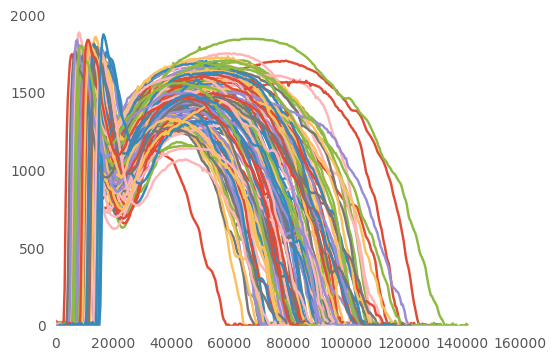

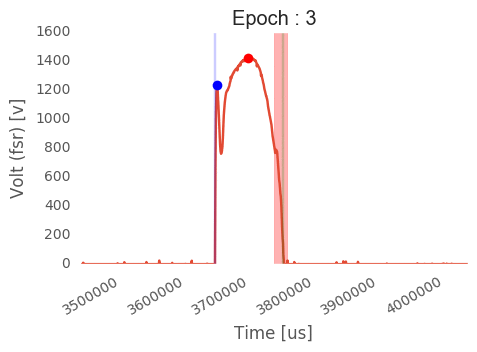

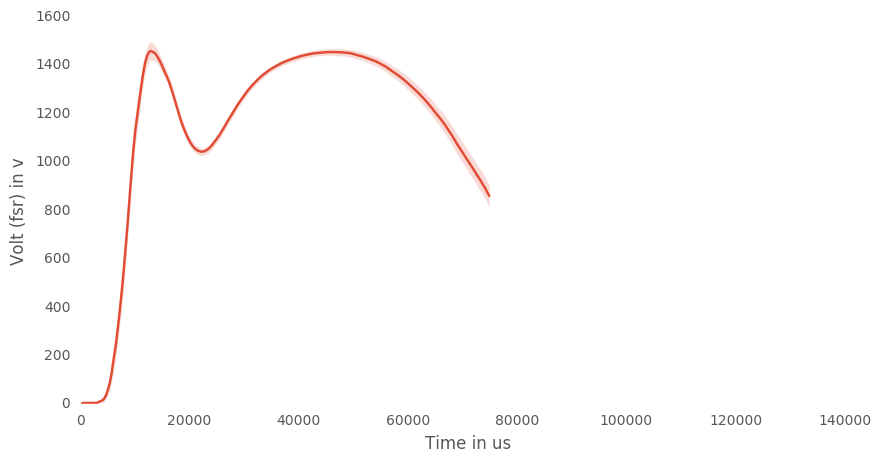

Epochs used in estimating IRI : 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130
Error epochs :  
Missing epochs :  1, 2


/Users/kangik/anaconda/lib/python3.5/site-packages/numpy/lib/function_base.py:4269: RuntimeWarning: Invalid value encountered in percentile
  interpolation=interpolation)


,FP_volt - SP_volt,LT - FT,SO - FP,SO - FT,SO - LT,SO - SP,SP - FP,area_under_curve_simps,area_under_curve_trapz,first_peak_time(FP),first_peak_voltage(FP_volt),first_touch_time(FT),last_touch_time(LT),second_peak_time(SP),second_peak_voltage(SP_volt)
epoch,,,,,,,,,,,,,,,
3,-0.151523,105120,87840,90720,-14400,39960,47880,1.201161e+08,1.201107e+08,3695264,0.992520,3692384,3797504,3743144,1.144043
4,0.173916,72360,39960,42840,-29520,4320,35640,7.820884e+07,7.819775e+07,4343624,1.217544,4340744,4413104,4379264,1.043628
5,0.289042,75960,23040,25560,-50400,-13680,36720,7.855774e+07,7.854494e+07,4960664,1.325152,4958144,5034104,4997384,1.036110
6,0.279744,74880,28080,30600,-44280,-3960,32040,8.761426e+07,8.760027e+07,5555744,1.394443,5553224,5628104,5587784,1.114699
7,0.215786,72360,48960,51840,-20520,10080,38880,8.092156e+07,8.090971e+07,6135344,1.316455,6132464,6204824,6174224,1.100669
8,0.271568,80640,67320,69840,-10800,24480,42840,8.776194e+07,8.773937e+07,6717104,1.362987,6714584,6795224,6759944,1.091420
9,0.215777,70920,63000,65520,-5400,27000,36000,8.609482e+07,8.607964e+07,7321544,1.373438,7319024,7389944,7357544,1.157661
10,0.057141,84240,21960,24840,-59400,-24480,46440,1.035082e+08,1.034875e+08,7963064,1.283848,7960184,8044424,8009504,1.226707
11,0.177085,78840,28080,30960,-47880,-11520,39600,8.696777e+07,8.695733e+07,8557424,1.279862,8554544,8633384,8597024,1.102777


In [1539]:
temporal_recalibration('/Users/kangik/Downloads/LeeSoft_exp_0_dataLog.txt')

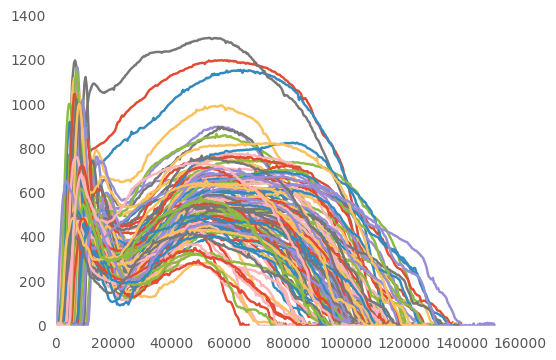

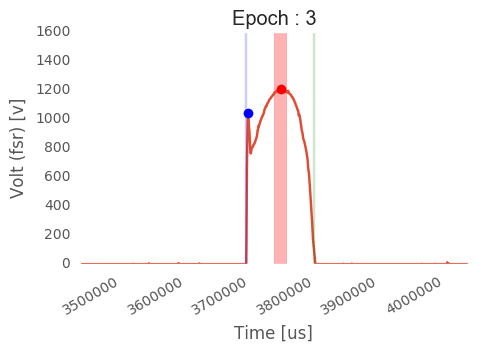

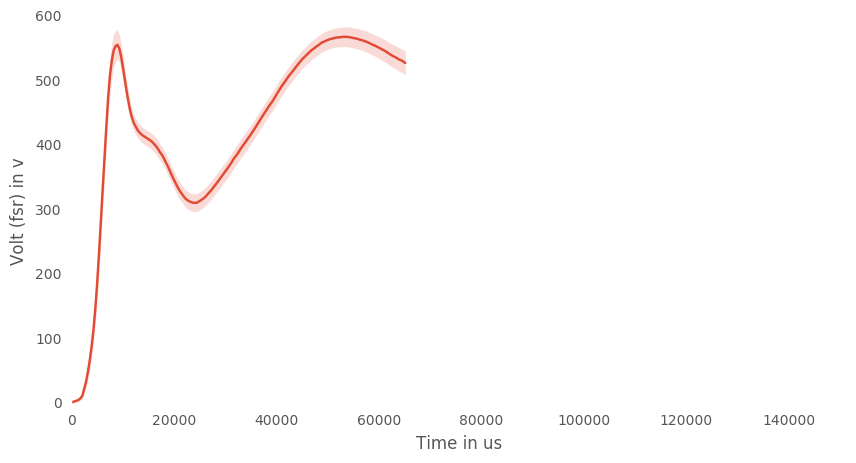

Epochs used in estimating IRI : 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 42, 43, 44, 45, 46, 47, 48, 49, 51, 52, 53, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 84, 85, 86, 87, 88, 89, 90, 91, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128
Error epochs :  
Missing epochs :  1, 2


/Users/kangik/anaconda/lib/python3.5/site-packages/numpy/lib/function_base.py:4269: RuntimeWarning: Invalid value encountered in percentile
  interpolation=interpolation)


,FP_volt - SP_volt,LT - FT,SO - FP,SO - FT,SO - LT,SO - SP,SP - FP,area_under_curve_simps,area_under_curve_trapz,first_peak_time(FP),first_peak_voltage(FP_volt),first_touch_time(FT),last_touch_time(LT),second_peak_time(SP),second_peak_voltage(SP_volt)
epoch,,,,,,,,,,,,,,,
3,-0.130489,104760,39960,42480,-62280,-10440,50400,1.024556e+08,1.024463e+08,3743385,0.837895,3740865,3845625,3793785,0.968384
4,-0.110987,106560,96480,98640,-7920,40320,56160,9.792589e+07,9.791163e+07,4286985,0.822464,4284825,4391385,4343145,0.933451
5,0.164597,74160,80640,84240,10080,37800,42840,4.269551e+07,4.269200e+07,4902945,0.722913,4899345,4973505,4945785,0.558316
6,-0.082175,102240,80280,82440,-19800,34200,46080,1.077327e+08,1.077099e+08,5503785,0.967585,5501625,5603865,5549865,1.049760
7,0.099394,96120,100800,102600,6480,50040,50760,7.210533e+07,7.209568e+07,6083385,0.903446,6081585,6177705,6134145,0.804053
8,0.092631,91440,81360,83880,-7560,34200,47160,5.362167e+07,5.361733e+07,6703665,0.715394,6701145,6792585,6750825,0.622763
9,0.055808,60120,67320,69480,9360,37080,30240,2.328646e+07,2.328154e+07,7317825,0.418475,7315665,7375785,7348065,0.362667
10,0.287923,57960,82440,85320,27360,57240,25200,2.636260e+07,2.635683e+07,7903185,0.687745,7900305,7958265,7928385,0.399821
11,0.090864,81000,202320,205200,124200,155880,46440,4.220238e+07,4.219731e+07,8383785,0.629853,8380905,8461905,8430225,0.538989


In [1538]:
temporal_recalibration('/Users/kangik/Downloads/BaeHard_exp_1_dataLog.txt')

> Data from DH

In [12]:
ls

README.md                   park_5_exp_1_dataLog.txt
Untitled.ipynb              park_5_exp_2_dataLog.txt
park_3_2_exp_0_dataLog.txt  park_5_exp_3_dataLog.txt
park_3_2_exp_1_dataLog.txt  park_5_exp_4_dataLog.txt
park_5_exp_0_dataLog.txt


## 1. Load data

In [1231]:
data = pd.read_csv('park_3_2_exp_1_dataLog.txt', sep=',')
# data = pd.read_csv('parkHard_exp_0_dataLog.txt', sep=',')

> How the raw data looks

In [1232]:
data.head()

,time[us],volt(fsr)[v],signal,signal frequency[Hz]
0,221869028,0,0,1000
1,221869389,0,0,1000
2,221869750,0,0,1000
3,221870110,0,0,1000
4,221870470,0,0,1000


## 2. Data observation

> Data shape

In [1233]:
data.shape

(217711, 4)

> `time[us]` column

In [1234]:
data['time[us]'].head()

0    221869028
1    221869389
2    221869750
3    221870110
4    221870470
Name: time[us], dtype: int64

- Range of the time

In [1235]:
print('starts from : {}\nends at : {}'.format(
    data['time[us]'].min(), 
    data['time[us]'].max()))

starts from : 221869028
ends at : 300492272


- Increasement in the time axis

    - eg) t2 - t1

In [1236]:
np.ediff1d(data['time[us]'])

array([361, 361, 360, ..., 360, 361, 361])

- Unique values of the time increasement

In [1237]:
np.unique(np.ediff1d(data['time[us]']))

array([ 358,  359,  360,  361,  362,  363,  364,  365,  366,  367,  368,
        369,  370,  371, 1060, 1061])

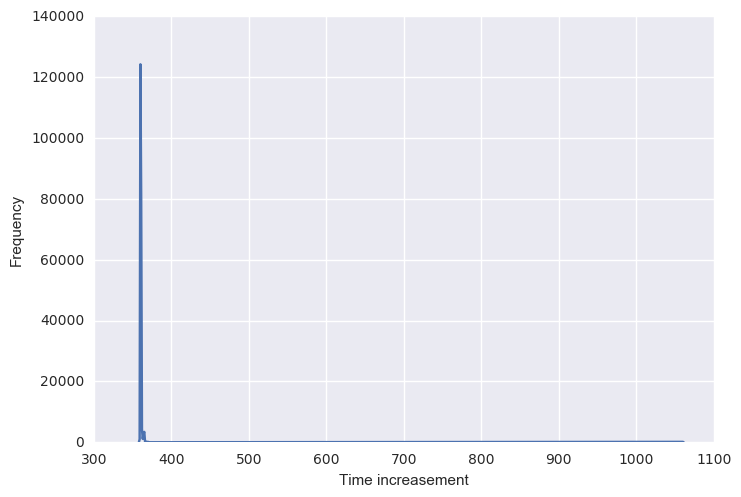

In [1238]:
tmp = pd.DataFrame(np.ediff1d(data['time[us]']))
tmp.columns = ['time increasement']
tmp = tmp.reset_index() 
plt.plot(tmp.groupby('time increasement').count().index, tmp.groupby('time increasement').count()['index'])
plt.ylabel('Frequency')
plt.xlabel('Time increasement')

In [1239]:
tmp.groupby('time increasement').count().T

time increasement,358,359,360,361,362,363,364,365,366,367,368,369,370,371,1060,1061
index,4,1025,124161,79961,4341,1134,2741,3423,104,184,188,96,150,23,155,20


In [1240]:
tmp.groupby('time increasement').count().index

Int64Index([ 358,  359,  360,  361,  362,  363,  364,  365,  366,  367,  368,
             369,  370,  371, 1060, 1061],
           dtype='int64', name='time increasement')

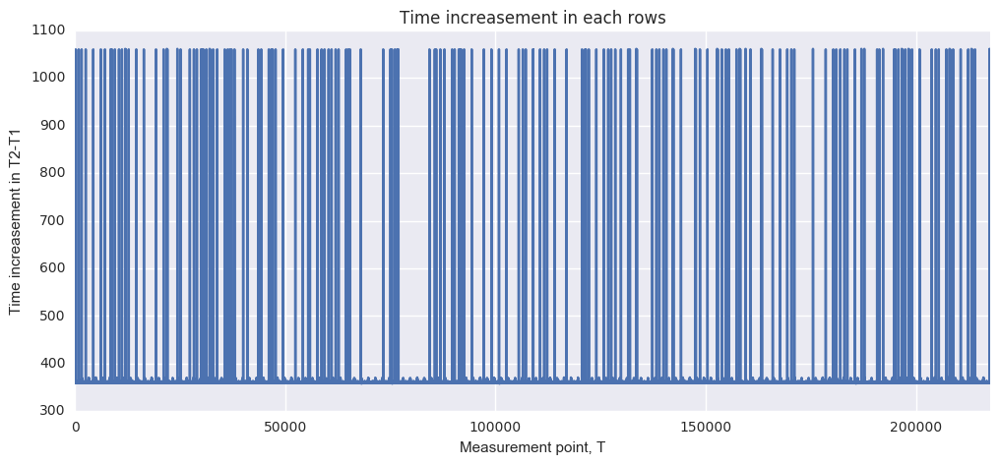

In [1241]:
plt.figure(figsize=(12,5))
plt.plot(np.ediff1d(data['time[us]']))
plt.title('Time increasement in each rows')
plt.xlim(0, len(tmp))
plt.xlabel('Measurement point, T')
plt.ylabel('Time increasement in T2-T1')
plt.show()

- Above shows that the time column is sparse

## 3. Interpolation

In [1242]:
f = interpolate.interp1d(data['time[us]'], data['volt(fsr)[v]'])
gap = 360
y = f(np.arange(data['time[us]'].min(), data['time[us]'].max(), gap))

f_signal = interpolate.interp1d(data['time[us]'], data['signal'], kind='nearest')
y_signal = f_signal(np.arange(data['time[us]'].min(), data['time[us]'].max(), gap))

> Data size before the interpolation

In [1243]:
len(data)

217711

> Data size after the interpolation

In [1244]:
len(y)

218398

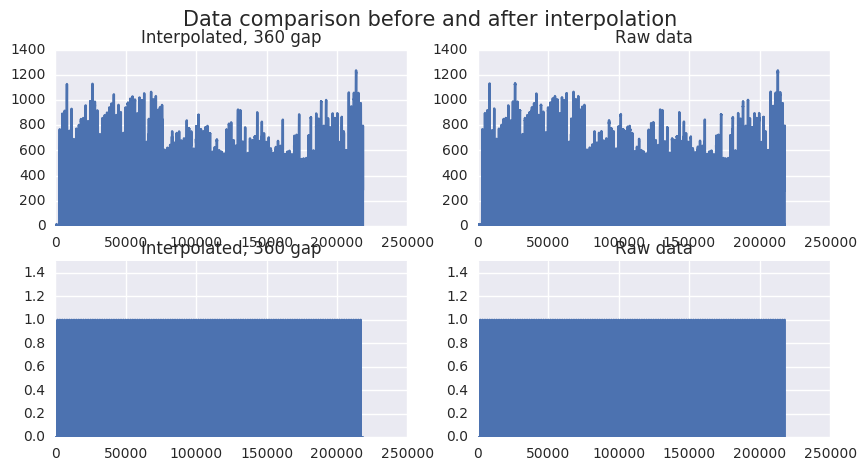

In [1245]:
fig, ax = plt.subplots(ncols=2, nrows=2, figsize=(10,5))
ax = np.ravel(ax)
ax[0].plot(y)
ax[0].set_title('Interpolated, 360 gap')
ax[1].plot(data['volt(fsr)[v]'])
ax[1].set_title('Raw data')

ax[2].plot(y_signal)
ax[2].set_title('Interpolated, 360 gap')
ax[2].set_ylim(0,1.5)
ax[3].plot(data['signal'])
ax[3].set_title('Raw data')
ax[3].set_ylim(0,1.5)

plt.suptitle('Data comparison before and after interpolation', fontsize=15)
plt.show()

> Save the interpolated as `data_reponse_interp_360`

In [1246]:
data_reponse_interp_360 = pd.DataFrame({'time[us]':np.arange(data['time[us]'].min(), data['time[us]'].max(), gap),
                                        'volt(fsr)[v]':y,
                                        'signal':y_signal})

## 5. Threshold the response

In [1247]:
threshold = 80
data_reponse_interp_360.loc[data_reponse_interp_360['volt(fsr)[v]'] < 80, 'volt(fsr)[v]'] = 0 

## 7. Split the dataframe

In [1248]:
# difference between consecutive element
pre_post_signal_diff = np.ediff1d(data_reponse_interp_360['signal'])

# where the difference is +1 : Signal turning on (0 --> 1)
# 1 has been added to return the index of first 'on'
signal_first_ones_index = np.where(pre_post_signal_diff==1)[0] + 1
signal_first_ones_time = data_reponse_interp_360.loc[signal_first_ones_index, 'time[us]'].values

signal_last_ones_index = np.where(pre_post_signal_diff==-1)[0]
signal_last_ones_time = data_reponse_interp_360.loc[signal_last_ones_index, 'time[us]'].values

# 300 ms
# need to make this multiples of 360
cut_window_div = 300000 / 360
cut_time = signal_first_ones_index - round(cut_window_div)

data_split = np.split(data_reponse_interp_360, 
                      cut_time)[1:]

In [1249]:
len(data_split)

130

## 8. Find peaks in each epochs

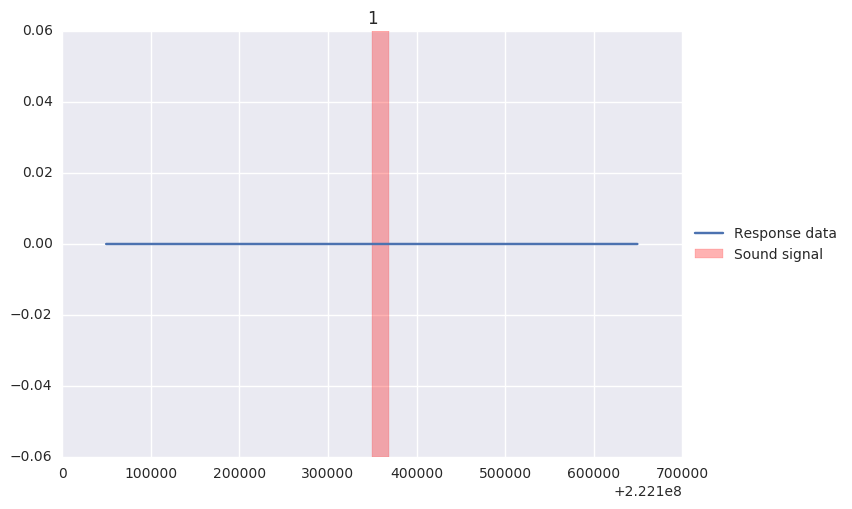

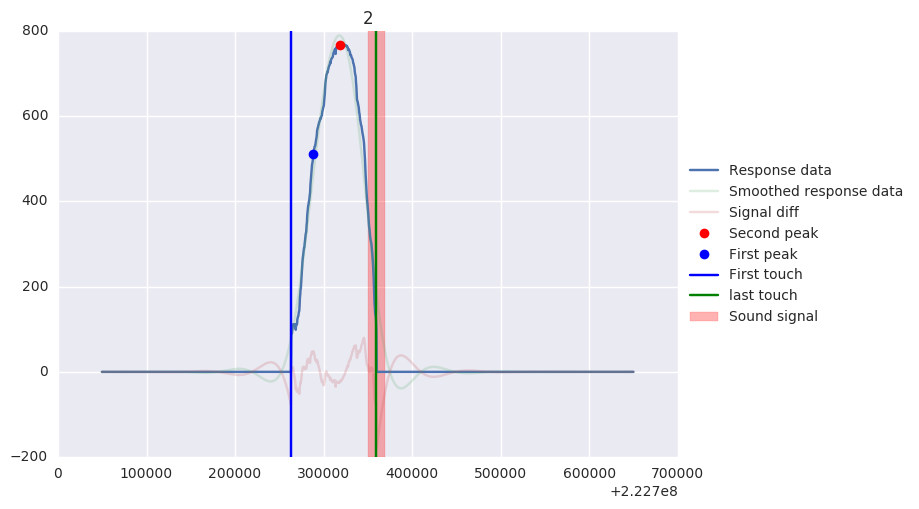

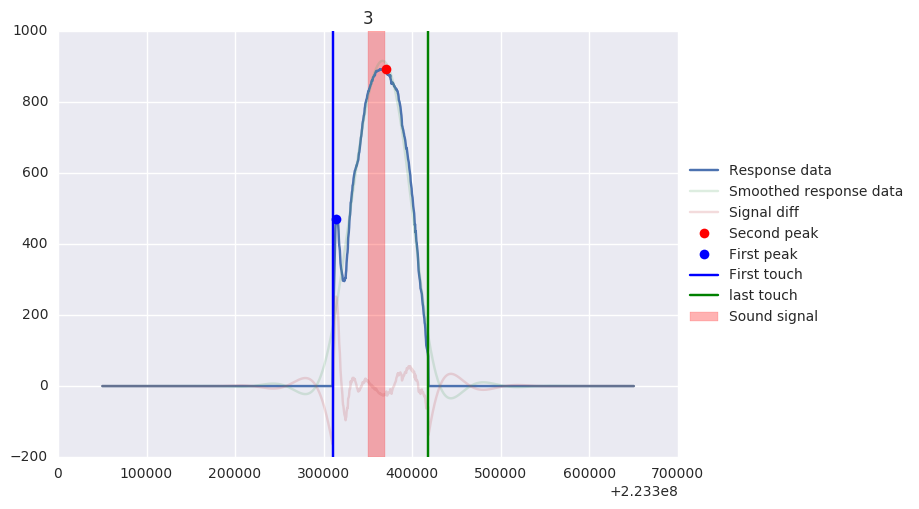

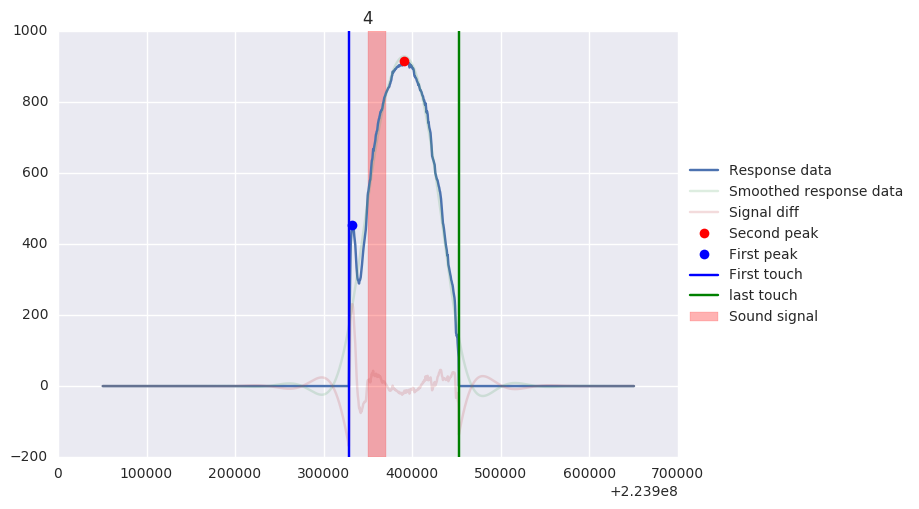

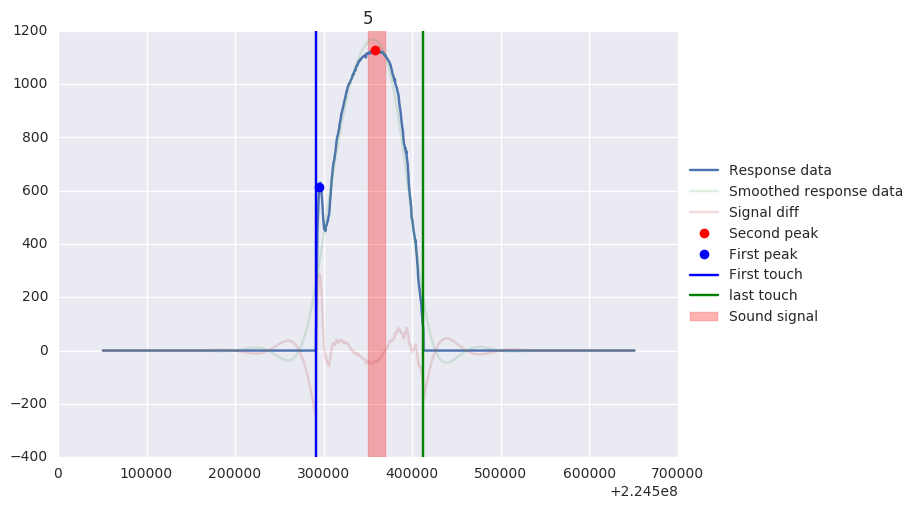

...

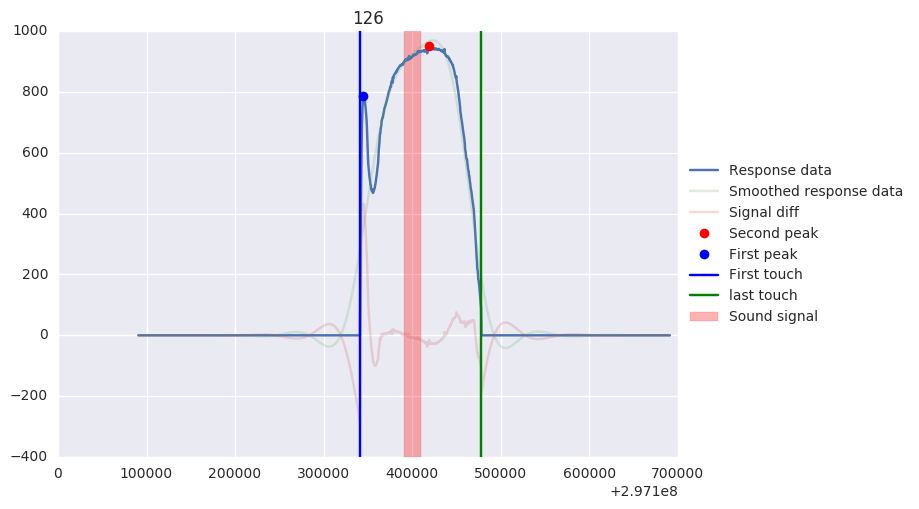

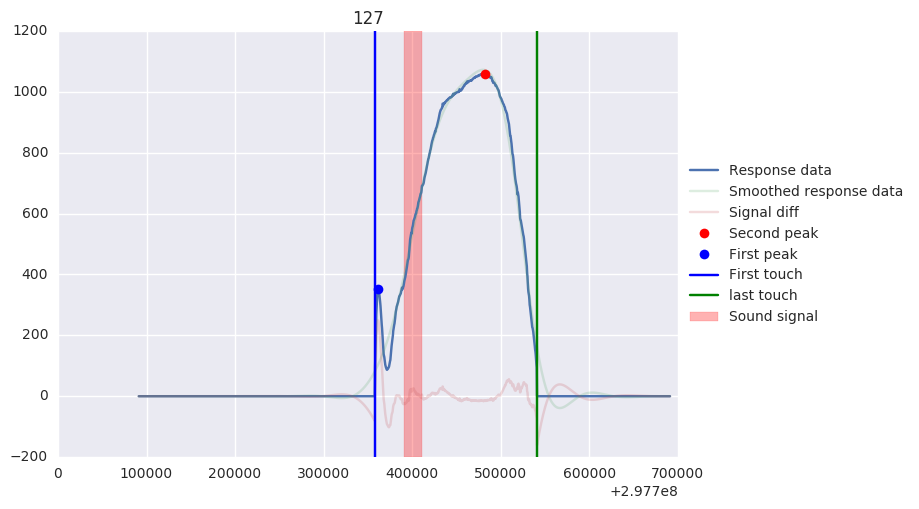

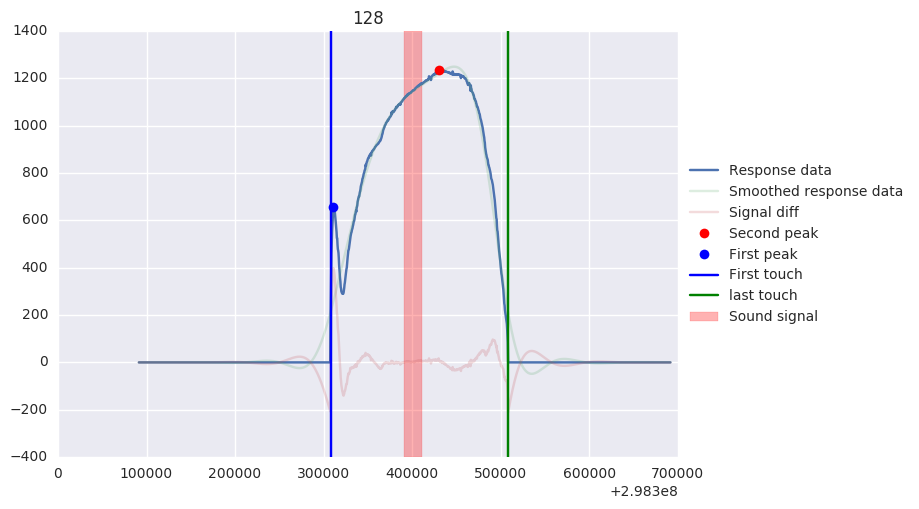

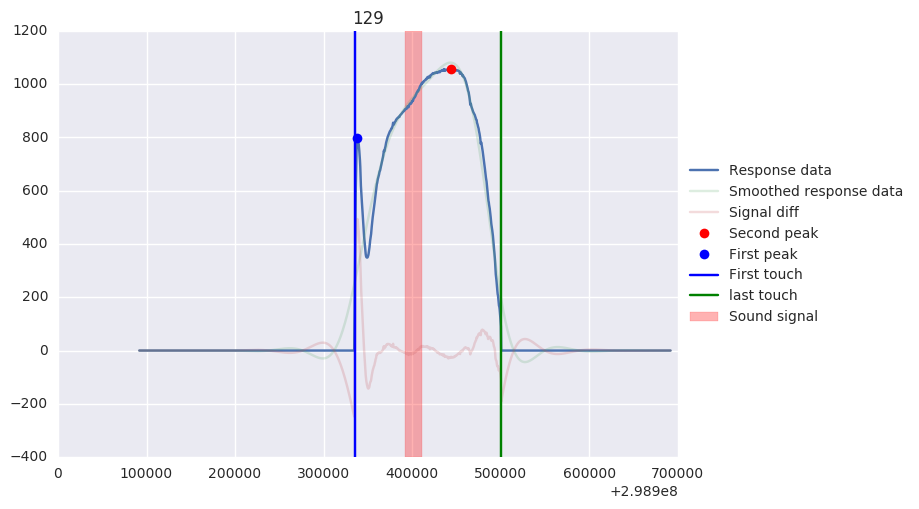

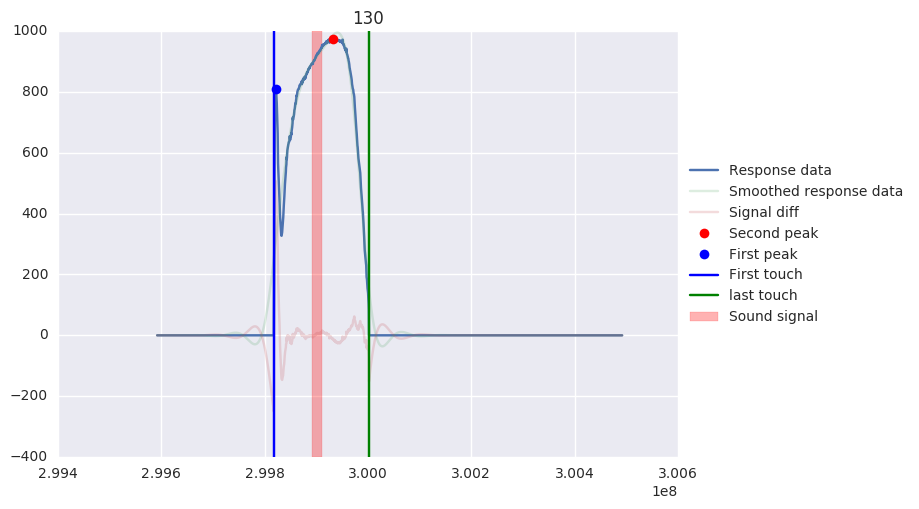

Error epochs :  2 46
Missing epochs :  1


In [1250]:
missing_epochs = []
error_epochs = []
for num, df_tmp in enumerate(data_split, 1):
    if len(df_tmp[df_tmp['volt(fsr)[v]'] > 80]) == 0:
        missing_epochs.append(num)
        plt.plot(df_tmp['time[us]'], df_tmp['volt(fsr)[v]'], label='Response data')
        plt.axvspan(df_tmp[df_tmp['signal']!=0]['time[us]'].values[0], 
                    df_tmp[df_tmp['signal']!=0]['time[us]'].values[-1], 
                    color='r', alpha=0.3, label = 'Sound signal')
        plt.title(num)
        plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
        plt.show()
        continue
        
    # if there are more than two responses
    elif np.any(np.diff(df_tmp[df_tmp['volt(fsr)[v]'] > 80].index)!=1):
        cut_index_thr = np.diff(df_tmp[df_tmp['volt(fsr)[v]'] > 80].index).argmax()
        cut_index = df_tmp[df_tmp['volt(fsr)[v]'] > 80].index.values[cut_index_thr]

        # select longer part of the response
        first_df_tmp = df_tmp.ix[:cut_index]
        second_df_tmp = df_tmp.ix[cut_index:]
        get_longer_df = lambda x,y : x if len(x[x['volt(fsr)[v]']>80]) > len(y[y['volt(fsr)[v]']>80]) else y
        new = get_longer_df(first_df_tmp, second_df_tmp)
        new = new.reindex_like(df_tmp)
        new['time[us]'] = df_tmp['time[us]']
        new['signal'] = df_tmp['signal']
        df_tmp = new
        df_tmp.ix[df_tmp.index[df_tmp.isnull()['volt(fsr)[v]']], 'volt(fsr)[v]'] = 0
        
            
    # first contact 
    first_touch_index = df_tmp[df_tmp['volt(fsr)[v]'] > 80].index.values[0]
    # last contact
    last_touch_index = df_tmp[df_tmp['volt(fsr)[v]'] > 80].index.values[-1]

    # Estimating second peak
    # Smooth data : strong smoothing
    b, a = signal.butter(4, 0.01)
    df_tmp['svolt(fsr)[v]'] = signal.filtfilt(b, a, df_tmp['volt(fsr)[v]'])

    max_response_index_from_strong_smoothing = df_tmp['svolt(fsr)[v]'].idxmax()
    second_window_time = 50
    lower_window_bound_2nd_peak = max_response_index_from_strong_smoothing - second_window_time
    higher_window_bound_2nd_peak = max_response_index_from_strong_smoothing + second_window_time
    second_peak_value = df_tmp['volt(fsr)[v]'].ix[lower_window_bound_2nd_peak:higher_window_bound_2nd_peak].max()
    second_peak_index = df_tmp['volt(fsr)[v]'].ix[lower_window_bound_2nd_peak:higher_window_bound_2nd_peak].idxmax()
    second_peak_time = df_tmp.ix[second_peak_index, 'time[us]']

    # First peak
    # must appear before the second peak
    first_peak_index = (df_tmp['volt(fsr)[v]'] - df_tmp['svolt(fsr)[v]']).ix[:second_peak_index].idxmax()
    first_peak_value = df_tmp.ix[first_peak_index, 'volt(fsr)[v]']
    first_peak_time = df_tmp.ix[first_peak_index, 'time[us]']

    # If first peak is far from the first touch
    if (first_peak_index - first_touch_index) > 25:
        error_epochs.append(num)

        
    # Plot gradient
    plt.plot(df_tmp['time[us]'], 
             df_tmp['volt(fsr)[v]'], label='Response data')
    plt.plot(df_tmp['time[us]'], 
             df_tmp['svolt(fsr)[v]'], alpha=0.2, label='Smoothed response data')
    plt.plot(df_tmp['time[us]'], 
             df_tmp['volt(fsr)[v]'] - df_tmp['svolt(fsr)[v]'], 
             alpha=0.2, label='Signal diff')
    plt.plot(second_peak_time, second_peak_value, 'ro', label='Second peak')
    plt.plot(first_peak_time, first_peak_value, 'bo', label='First peak')
    plt.axvspan(df_tmp[df_tmp['signal']!=0]['time[us]'].values[0], 
                df_tmp[df_tmp['signal']!=0]['time[us]'].values[-1], 
                color='r', alpha=0.3, label = 'Sound signal')
    plt.axvline(df_tmp.ix[first_touch_index, 'time[us]'], label = 'First touch')
    plt.axvline(df_tmp.ix[last_touch_index, 'time[us]'], color='green', label = 'last touch')
    plt.title(num)
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))


    plt.show()

print('Error epochs : ', ' '.join([str(x) for x in error_epochs]))
print('Missing epochs : ', ' '.join([str(x) for x in missing_epochs]))

> Save the df

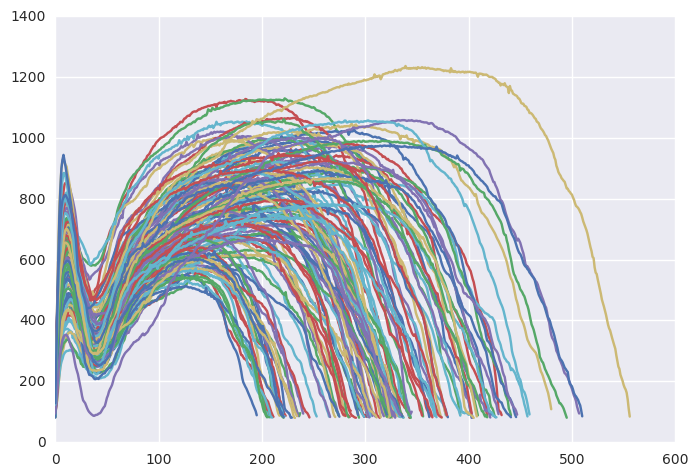

In [1251]:
response_only_df = pd.DataFrame()
timing_df = pd.DataFrame()
timing_diff_df = pd.DataFrame()
for num, df_tmp in enumerate(data_split, 1):
    if len(df_tmp[df_tmp['volt(fsr)[v]'] > 80]) == 0:
        missing_epochs.append(num)
        continue
        
    # if there are more than two responses
    elif np.any(np.diff(df_tmp[df_tmp['volt(fsr)[v]'] > 80].index)!=1):
        cut_index_thr = np.diff(df_tmp[df_tmp['volt(fsr)[v]'] > 80].index).argmax()
        cut_index = df_tmp[df_tmp['volt(fsr)[v]'] > 80].index.values[cut_index_thr]

        # select longer part of the response
        first_df_tmp = df_tmp.ix[:cut_index]
        second_df_tmp = df_tmp.ix[cut_index:]
        get_longer_df = lambda x,y : x if len(x[x['volt(fsr)[v]']>80]) > len(y[y['volt(fsr)[v]']>80]) else y
        new = get_longer_df(first_df_tmp, second_df_tmp)
        new = new.reindex_like(df_tmp)
        new['time[us]'] = df_tmp['time[us]']
        new['signal'] = df_tmp['signal']
        df_tmp = new
        df_tmp.ix[df_tmp.index[df_tmp.isnull()['volt(fsr)[v]']], 'volt(fsr)[v]'] = 0

    # first contact 
    first_touch_index = df_tmp[df_tmp['volt(fsr)[v]'] > 80].index.values[0]
    first_touch_time = df_tmp.ix[first_touch_index, 'time[us]']
    # last contact
    last_touch_index = df_tmp[df_tmp['volt(fsr)[v]'] > 80].index.values[-1]
    last_touch_time = df_tmp.ix[last_touch_index, 'time[us]']
    
    # sound first
    first_sound_index = df_tmp[df_tmp['signal']!=0].index.values[0]
    first_sound_time = df_tmp.ix[first_sound_index, 'time[us]']
    
    # Estimating second peak
    # Smooth data : strong smoothing
    b, a = signal.butter(4, 0.01)
    df_tmp['svolt(fsr)[v]'] = signal.filtfilt(b, a, df_tmp['volt(fsr)[v]'])

    max_response_index_from_strong_smoothing = df_tmp['svolt(fsr)[v]'].idxmax()
    second_window_time = 50
    lower_window_bound_2nd_peak = max_response_index_from_strong_smoothing - second_window_time
    higher_window_bound_2nd_peak = max_response_index_from_strong_smoothing + second_window_time
    second_peak_value = df_tmp['volt(fsr)[v]'].ix[lower_window_bound_2nd_peak:higher_window_bound_2nd_peak].max()
    second_peak_index = df_tmp['volt(fsr)[v]'].ix[lower_window_bound_2nd_peak:higher_window_bound_2nd_peak].idxmax()
    second_peak_time = df_tmp.ix[second_peak_index, 'time[us]']

    # First peak
    # must appear before the second peak
    first_peak_index = (df_tmp['volt(fsr)[v]'] - df_tmp['svolt(fsr)[v]']).ix[:second_peak_index].idxmax()
    first_peak_value = df_tmp.ix[first_peak_index, 'volt(fsr)[v]']
    first_peak_time = df_tmp.ix[first_peak_index, 'time[us]']
    
    
    timing_df_tmp = pd.DataFrame({'epoch':[num],
                              'first_touch_time':first_touch_time,
                              'first_peak_time':first_peak_time,
                              'first_peak_amplitude':first_peak_value,
                              'second_peak_time':second_peak_time,
                              'second_peak_amplitude':second_peak_value,
                              'last_touch_time':last_touch_time})
    
    timing_diff_df_tmp = pd.DataFrame({'epoch':[num],
                                       'diff_in_peak':second_peak_time-first_peak_time,
                                       'touch_duration':last_touch_time-first_touch_time,
                                       'diff_in_peak_1_to_sound_onset':first_sound_time-first_peak_time,
                                       'diff_in_peak_2_to_sound_onset':first_sound_time-second_peak_time,
                                       'diff_in_first_touch_to_sound_onset':first_sound_time-first_touch_time,
                                       'diff_in_last_touch_to_sound_onset':first_sound_time-last_touch_time,
                                      })
    timing_df = pd.concat([timing_df, timing_df_tmp.set_index('epoch')])
    timing_diff_df = pd.concat([timing_diff_df, timing_diff_df_tmp.set_index('epoch')])

        
    if num not in error_epochs and num not in missing_epochs:
        df_tmp = df_tmp[df_tmp['volt(fsr)[v]'] != 0].reset_index()
        response_only_df = pd.concat([response_only_df, df_tmp['volt(fsr)[v]']], axis=1)
        plt.plot(df_tmp.reset_index().index, df_tmp['volt(fsr)[v]'])
plt.show()

In [1252]:
timing_df

,first_peak_amplitude,first_peak_time,first_touch_time,last_touch_time,second_peak_amplitude,second_peak_time
epoch,,,,,,
2,511.650000,222988268,222963428,223059548,768.000000,223018508
3,471.734072,223613948,223610348,223717988,892.419444,223670828
4,452.238227,224232068,224228828,224352308,915.350000,224291108
5,615.025000,224795108,224791508,224912468,1127.412088,224857748
6,470.797784,225430868,225427628,225526268,755.927778,225486668
7,533.177285,225973388,225970148,226081388,930.627778,226038188
8,366.800000,226597628,226594748,226690148,690.700000,226648028
9,464.085873,227198108,227194148,227311508,772.450549,227257508
10,387.355556,227842508,227839628,227955548,802.541667,227915948


In [1253]:
timing_diff_df.describe()

,diff_in_first_touch_to_sound_onset,diff_in_last_touch_to_sound_onset,diff_in_peak,diff_in_peak_1_to_sound_onset,diff_in_peak_2_to_sound_onset,touch_duration
count,129.000000,129.000000,129.000000,129.000000,129.000000,129.000000
mean,99828.837209,-18541.395349,67317.209302,95642.790698,28325.581395,118370.232558
std,63746.587747,74830.469070,19617.703221,63074.048385,69614.505267,27336.382478
min,-139680.000000,-271080.000000,30240.000000,-143280.000000,-219960.000000,70200.000000
25%,62280.000000,-60480.000000,52200.000000,57960.000000,-6120.000000,100800.000000
50%,101880.000000,-15120.000000,64800.000000,97560.000000,27360.000000,117360.000000
75%,138600.000000,34560.000000,79200.000000,134280.000000,75600.000000,134640.000000
max,299880.000000,175680.000000,120960.000000,263160.000000,221040.000000,200160.000000


In [1230]:
timing_df.to_csv('/Users/kangik/Downloads/hard_timing_2017_09_26.csv')
timing_diff_df.to_csv('/Users/kangik/Downloads/hard_timing_diff_2017_09_26.csv')

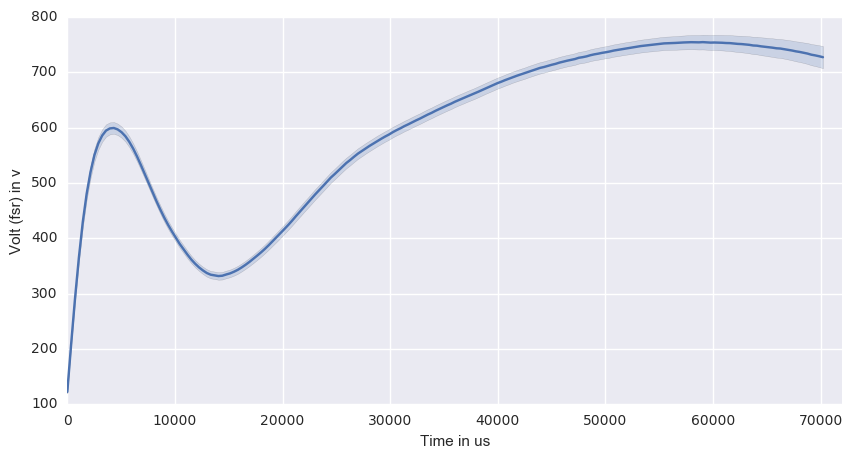

In [1254]:
response_only_df.columns = np.arange(1, len(response_only_df.columns)+1)
response_only_df = response_only_df.stack().reset_index()
response_only_df.columns = ['time', 'epoch', 'response']
response_only_df['time'] = response_only_df['time']*360
fig, axes = plt.subplots(ncols=1, figsize=(10,5))
ax = sns.tsplot(data=response_only_df, 
                time='time', 
                unit='epoch', 
                value='response', 
                ax=axes)
ax.set_xlim(0, 72000)
ax.set_xlabel('Time in us')
ax.set_ylabel('Volt (fsr) in v')
plt.show()

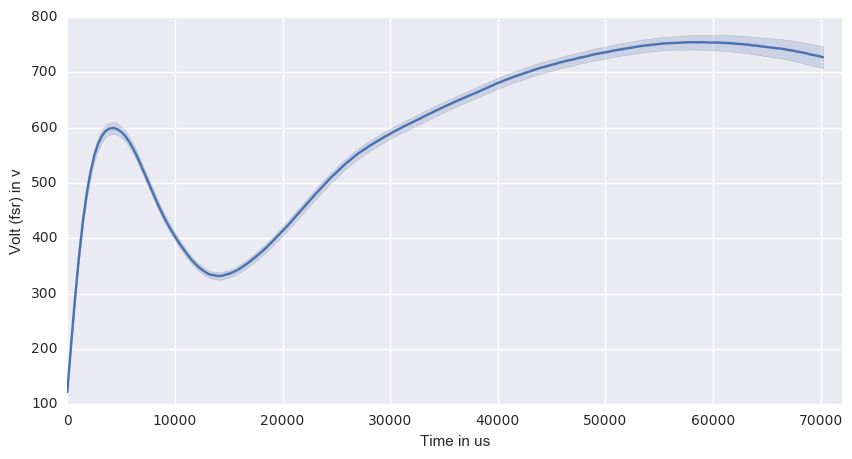

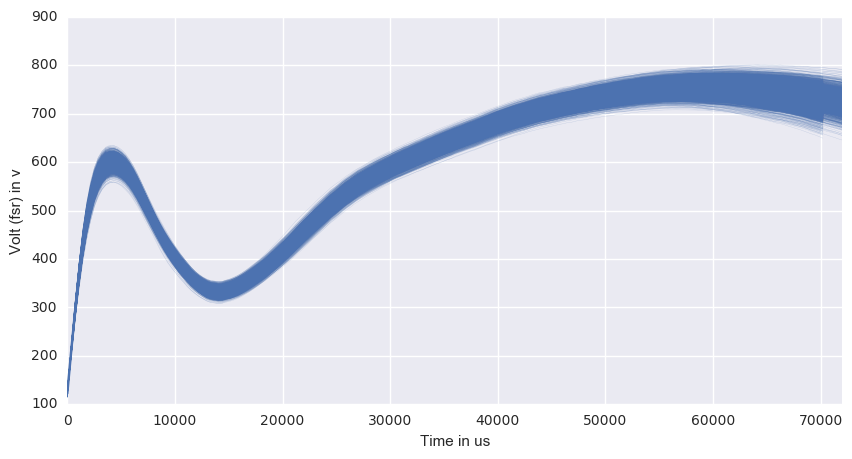

In [1168]:
fig, axes = plt.subplots(ncols=1, figsize=(10,5))
ax = sns.tsplot(data=response_only_df, 
                time='time', 
                unit='epoch', 
                value='response', 
                err_style='boot_traces',
                ax=axes)
ax.set_xlim(0, 72000)
ax.set_xlabel('Time in us')
ax.set_ylabel('Volt (fsr) in v')
plt.show()

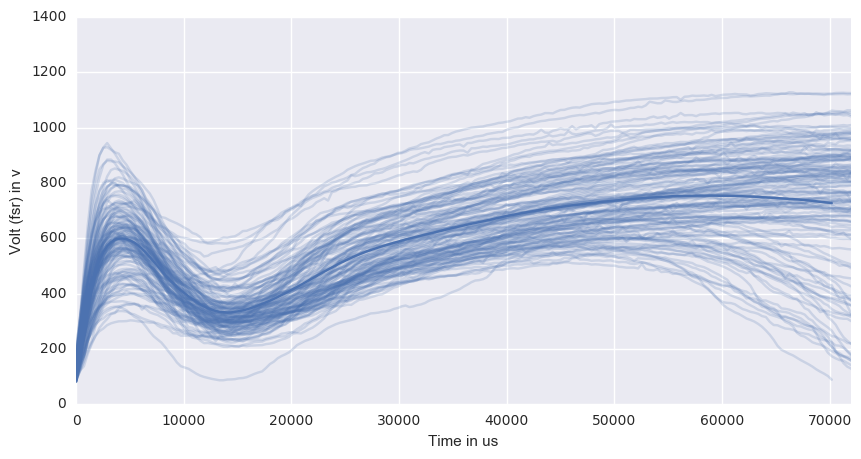

In [1170]:
fig, axes = plt.subplots(ncols=1, figsize=(10,5))
ax = sns.tsplot(data=response_only_df, 
                time='time', 
                unit='epoch', 
                value='response', 
                err_style='unit_traces',
                ax=axes)
ax.set_xlim(0, 72000)
ax.set_xlabel('Time in us')
ax.set_ylabel('Volt (fsr) in v')
plt.show()

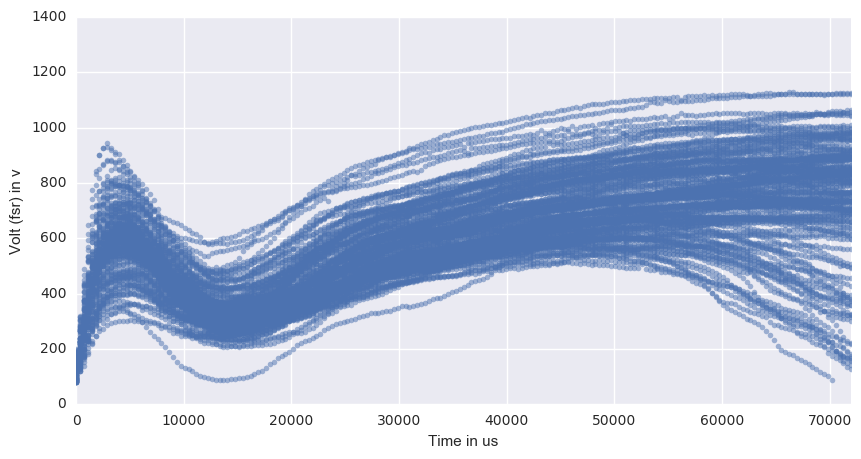

In [1171]:
fig, axes = plt.subplots(ncols=1, figsize=(10,5))
ax = sns.tsplot(data=response_only_df, 
                time='time', 
                unit='epoch', 
                value='response', 
                err_style='unit_points',
                ax=axes)
ax.set_xlim(0, 72000)
ax.set_xlabel('Time in us')
ax.set_ylabel('Volt (fsr) in v')
plt.show()

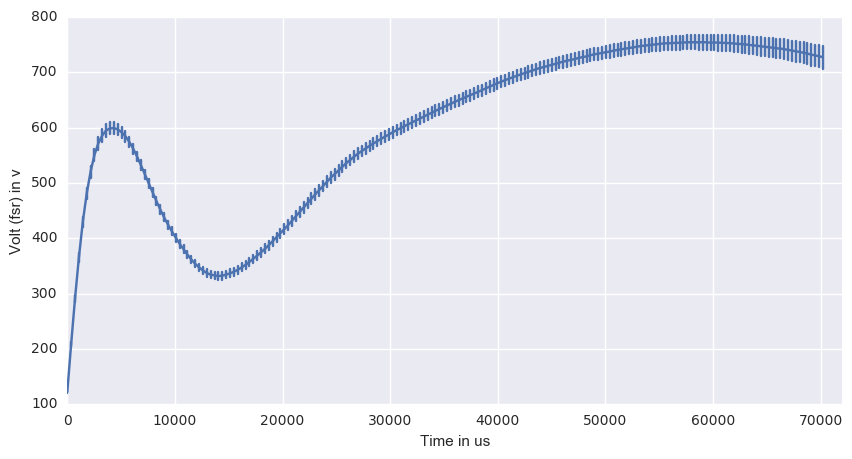

In [1172]:
fig, axes = plt.subplots(ncols=1, figsize=(10,5))
ax = sns.tsplot(data=response_only_df, 
                time='time', 
                unit='epoch', 
                value='response', 
                err_style='ci_bars',
                ax=axes)
ax.set_xlim(0, 72000)
ax.set_xlabel('Time in us')
ax.set_ylabel('Volt (fsr) in v')
plt.show()

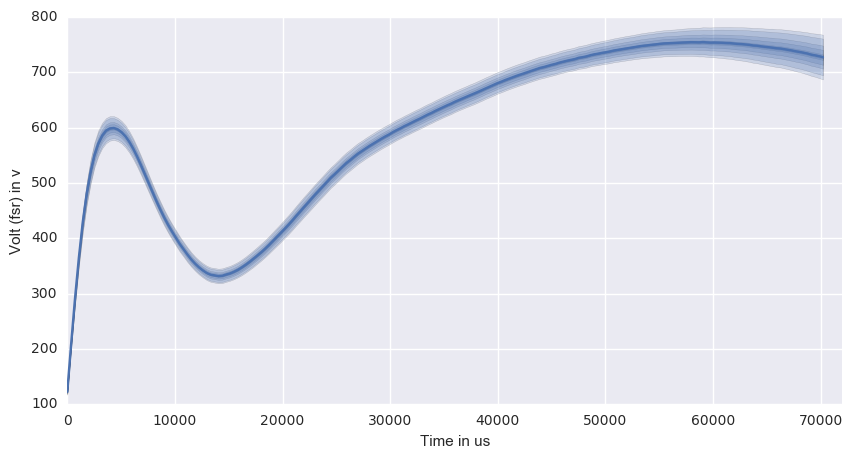

In [1190]:
fig, axes = plt.subplots(ncols=1, figsize=(10,5))
ax = sns.tsplot(data=response_only_df, 
                time='time', 
                unit='epoch', 
                value='response', 
#                 err_style='ci_band',
#                 color='g',
#                 interpolate=False,
#                 n_boot=5000,
                ci=[1,10,20,50,70,90,95],
                ax=axes)
ax.set_xlim(0, 72000)
ax.set_xlabel('Time in us')
ax.set_ylabel('Volt (fsr) in v')
plt.show()

In [1389]:
ho,ha = df_tmp[df_tmp['volt(fsr)[v]'] > 80].index.values[[0,-1]]

In [1390]:
ho

0

In [1391]:
hab


510

In [1451]:
import os

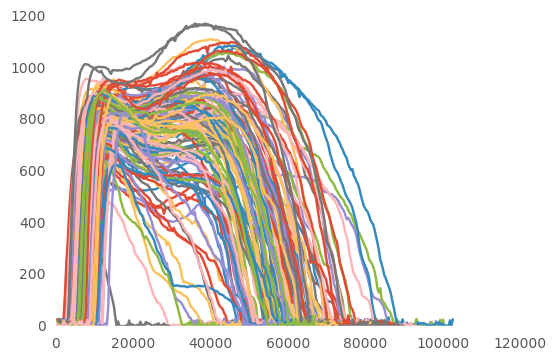

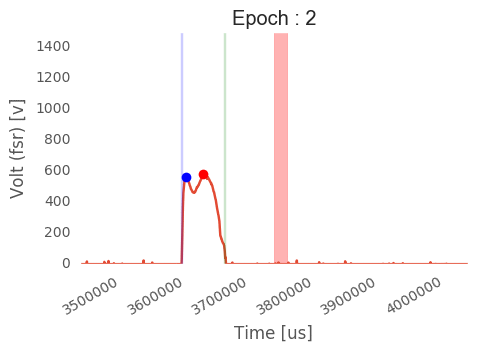

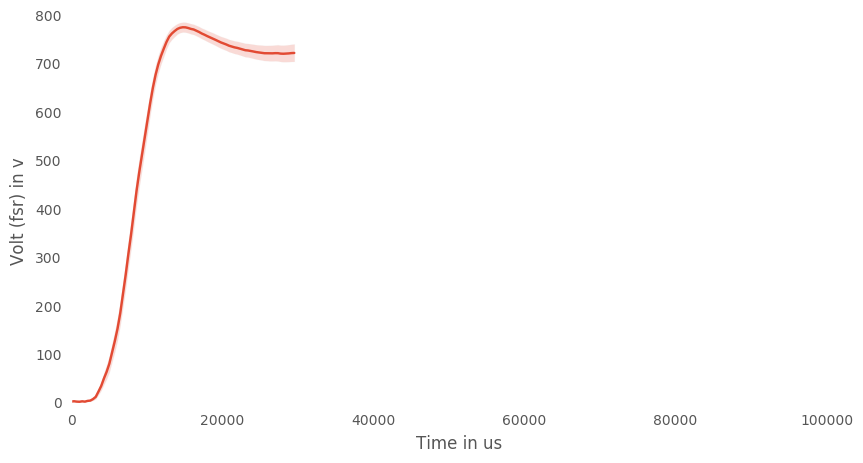

Error epochs :  26, 98, 116
Missing epochs :  1


,diff_in_first_touch_to_sound_onset,diff_in_last_touch_to_sound_onset,diff_in_peak,diff_in_peak_1_to_sound_onset,diff_in_peak_2_to_sound_onset,touch_duration
count,126,126,126,126,126,126
mean,98002,46948,20865,92240,71374,51054
std,24693,23686,7466,24631,23730,11205


In [1480]:
temporal_recalibration('ChoSoft_exp_0_dataLog.txt')

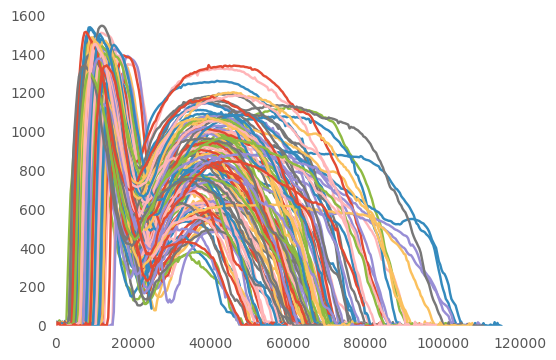

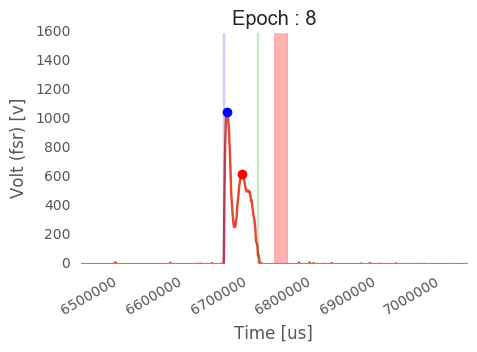

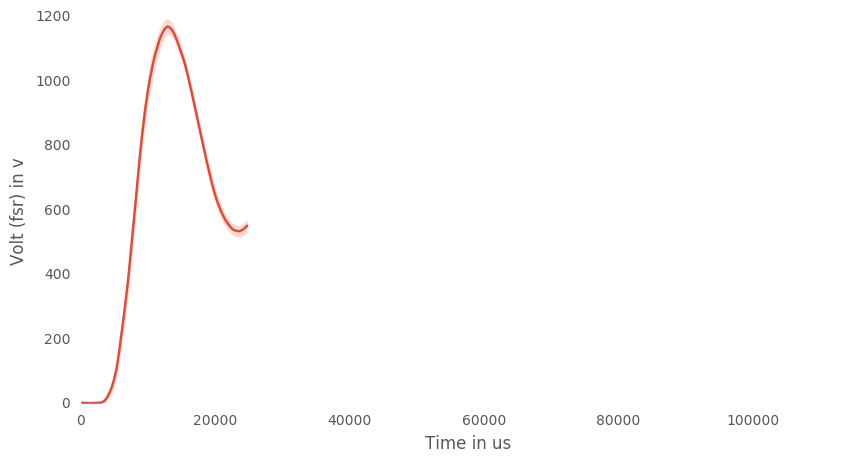

Error epochs :  12, 16, 26, 42
Missing epochs :  1, 2, 3, 4, 5, 6, 7


,diff_in_first_touch_to_sound_onset,diff_in_last_touch_to_sound_onset,diff_in_peak,diff_in_peak_1_to_sound_onset,diff_in_peak_2_to_sound_onset,touch_duration
count,120,120,120,120,120,120
mean,35370,-23325,28833,31659,2826,58695
std,34623,31929,5789,34546,33005,13824


In [1491]:
temporal_recalibration('/Users/kangik/Downloads/LeeHard_exp_1_dataLog.txt')

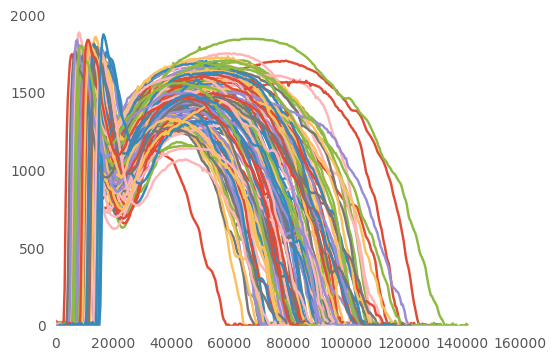

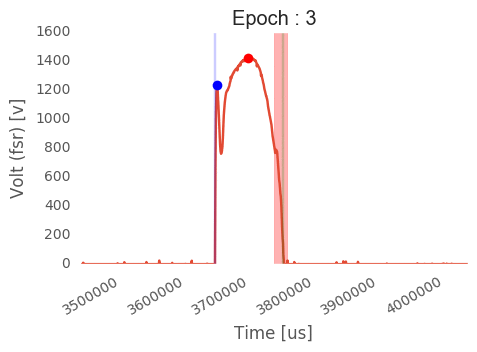

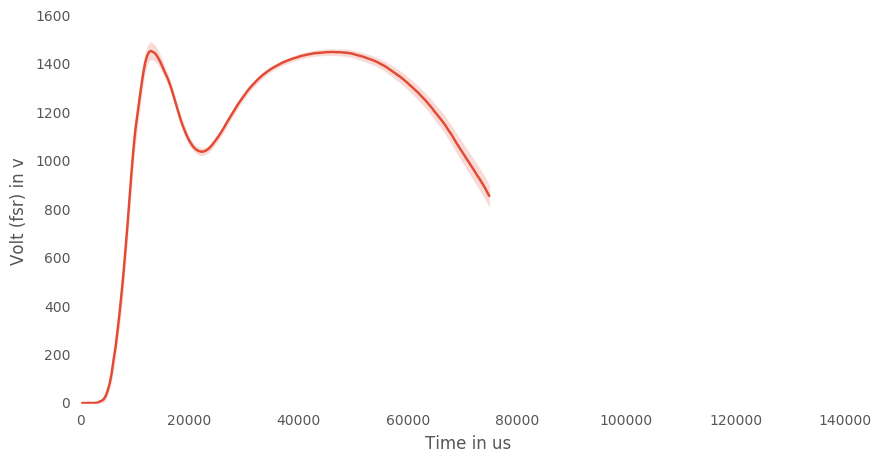

Error epochs :  
Missing epochs :  1, 2


,diff_in_first_touch_to_sound_onset,diff_in_last_touch_to_sound_onset,diff_in_peak,diff_in_peak_1_to_sound_onset,diff_in_peak_2_to_sound_onset,touch_duration
count,128,128,128,128,128,128
mean,55679,-25242,38131,52962,14830,80921
std,31335,30444,8204,31279,29472,13716


In [1490]:
temporal_recalibration('/Users/kangik/Downloads/LeeSoft_exp_0_dataLog.txt')

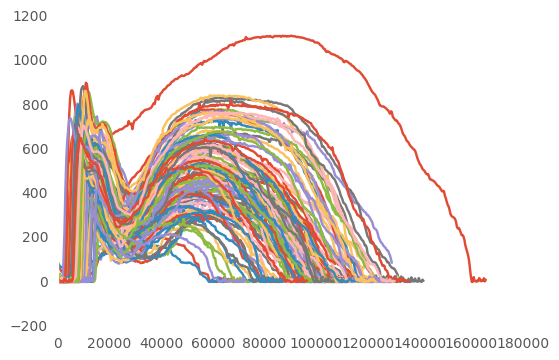

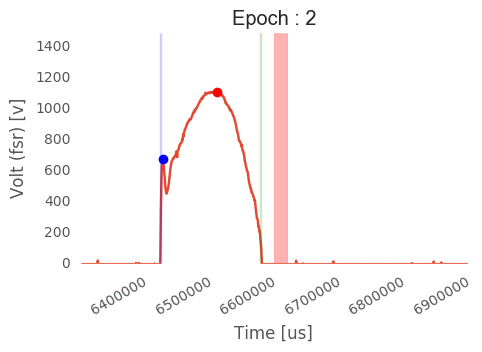

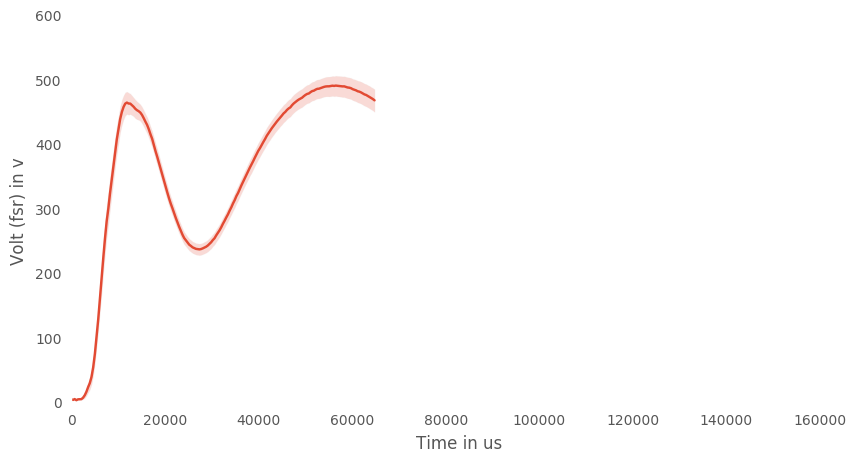

Error epochs :  9, 10, 11, 12, 13, 21, 22, 23, 24, 27, 44, 65, 70, 71, 72, 78
Missing epochs :  1


,diff_in_first_touch_to_sound_onset,diff_in_last_touch_to_sound_onset,diff_in_peak,diff_in_peak_1_to_sound_onset,diff_in_peak_2_to_sound_onset,touch_duration
count,113,113,113,113,113,113
mean,64398,-24932,49629,61652,12023,89330
std,28530,28891,7657,28603,27754,16748


In [1486]:
temporal_recalibration('/Users/kangik/Downloads/BaeSoft_exp_1_dataLog.txt')

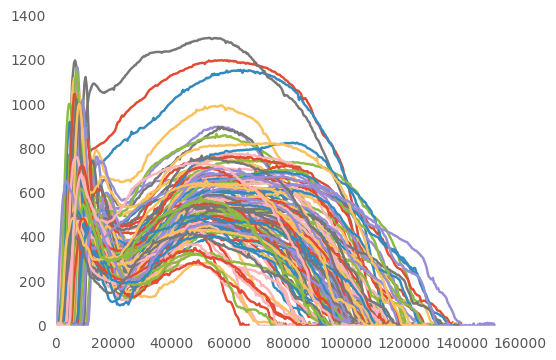

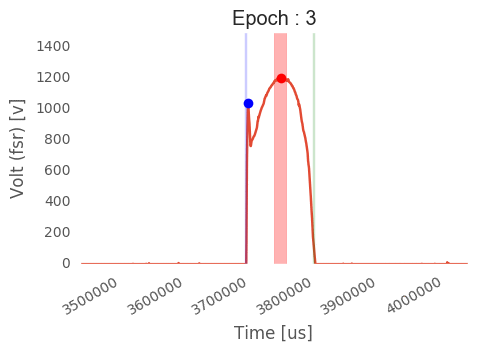

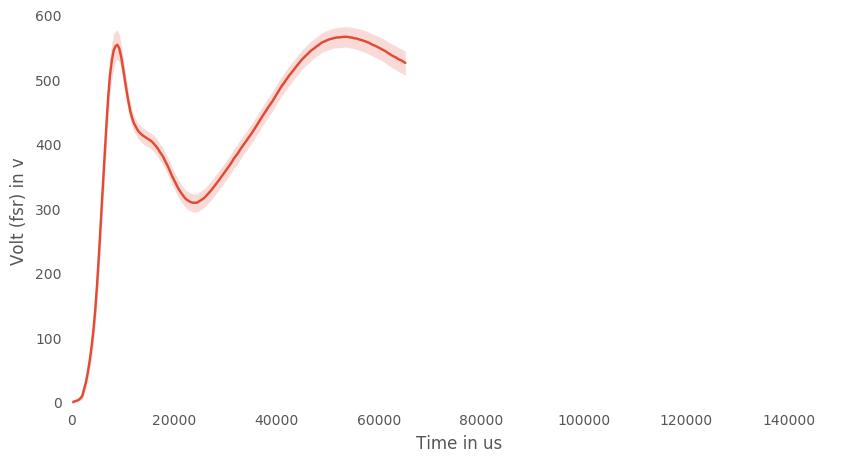

Error epochs :  41, 50, 54, 81, 82, 83, 92, 129
Missing epochs :  1, 2


,diff_in_first_touch_to_sound_onset,diff_in_last_touch_to_sound_onset,diff_in_peak,diff_in_peak_1_to_sound_onset,diff_in_peak_2_to_sound_onset,touch_duration
count,119,119,119,119,119,119
mean,77030,-17594,51734,74495,22761,94625
std,34300,39225,10430,34161,36805,15538


In [1485]:
temporal_recalibration('/Users/kangik/Downloads/BaeHard_exp_1_dataLog.txt')